#  <span style="color:blue">AutoML com Pycaret</span>


# Clustering


#### Carregando o módulo de clustering.

In [1]:
from pycaret.clustering import *
import pandas as pd
import seaborn as sns

# Carregando os dados

In [2]:
dataset = pd.read_csv("datasets/bankmarketing.csv")

In [4]:
dataset.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [5]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

##### Verificando a forma dos dados

In [6]:
dataset.shape

(41188, 21)

# Configurando o ambiente com a função Setup.

In [7]:
exp_clu101 = setup(
                     data = dataset
                    ,profile = True
                    ,session_id = 123
                )

,Description,Value
0,Session id,123
1,Original data shape,"(41188, 21)"
2,Transformed data shape,"(41188, 63)"
3,Ordinal features,2
4,Numeric features,10
5,Categorical features,11
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


Loading profile... Please Wait!
Profiler Failed. No output to show, continue with modeling.


In [14]:
from pycaret.clustering import *

exp_clu101 = setup(
                     data = dataset
                    ,profile = False
                    ,session_id = 123
                    ,normalize = True
                    ,ordinal_features = {'education' : 
                                         [ 
                                              'unknown'
                                             ,'illiterate'
                                             ,'basic.4y'
                                             ,'basic.6y'
                                             ,'basic.9y'
                                             ,'high.school'
                                             ,'professional.course'
                                             ,'university.degree'
                                         ]
                                      }
                )

,Description,Value
0,Session id,123
1,Original data shape,"(41188, 21)"
2,Transformed data shape,"(41188, 63)"
3,Ordinal features,3
4,Numeric features,10
5,Categorical features,11
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


##### Armazenando o Dataframe transformado.

In [15]:
df_transformed = get_config("X")

In [16]:
df_transformed.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no


In [17]:
df_transformed.shape

(41188, 21)

#### Verificando a lista de modelos disponíveis

In [18]:
models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch


# Criando o modelo Kmeans

In [19]:
kmeans = create_model('kmeans')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0496,2204.5623,3.5333,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

In [20]:
print(kmeans)

KMeans(n_clusters=4, random_state=123)


# Atribuindo o cluster aos dados.

In [21]:
kmean_results = assign_model(kmeans)
kmean_results.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no,Cluster 0
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no,Cluster 0
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no,Cluster 0
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no,Cluster 0
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,999,0,nonexistent,1.1,93.994003,-36.400002,4.857,5191.0,no,Cluster 0


# Analisando os resultados.

### Cluster PCA Plot

In [23]:
plot_model(kmeans)

### Elbow Plot

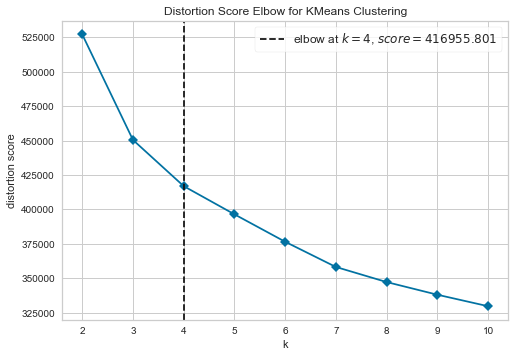

In [43]:
plot_model(kmeans, plot = 'elbow')

### Distribution Plot

In [22]:
plot_model(kmeans, plot = 'distribution')

# Tune do modelo de agrupamento para uma tarefa de classificação.

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8978,0.8820,0.1454,0.3842,0.1609,0.1061,0.1298
2,0.8982,0.8795,0.1545,0.3766,0.1776,0.1223,0.1457
4,0.8986,0.8810,0.1491,0.3367,0.1684,0.1141,0.1371
5,0.8987,0.8811,0.1497,0.3921,0.1686,0.1144,0.1395
6,0.8984,0.8807,0.1501,0.3764,0.1698,0.1152,0.1394
8,0.8981,0.8788,0.1521,0.2750,0.1748,0.1196,0.1376
10,0.8979,0.8809,0.1549,0.3522,0.1743,0.1187,0.1445
14,0.8979,0.8776,0.1545,0.3434,0.1738,0.1177,0.1432
18,0.8990,0.8811,0.1487,0.3689,0.1684,0.1147,0.1362
25,0.9013,0.8812,0.1486,0.3348,0.1813,0.1305,0.1533


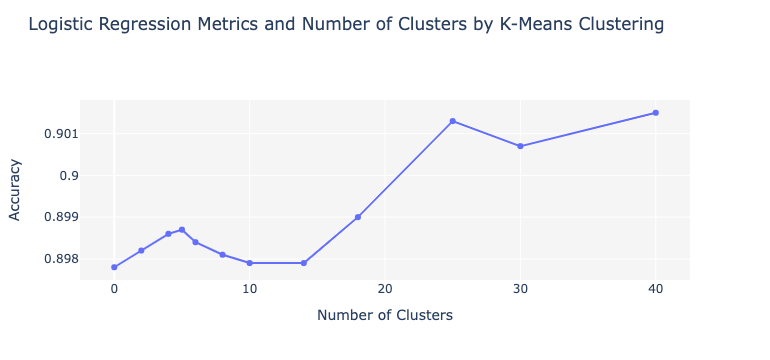

In [45]:
tuned_kmeans = tune_model(model = 'kmeans', supervised_target = 'y')

##### Verificando o objeto.

In [46]:
tuned_kmeans

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=40, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)

# Persistindo o modelo

In [47]:
save_model(kmeans,'kmeans_model')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[],
                                       target='UNSUPERVISED_DUMMY_TARGET',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None...
                 ('fix_perfect', Remove_100(target='UNSUPERVISED_DUMMY_TARGET')),
                 ('clean_names', Clean_Colum_Names()),
                 ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                 ('dfs', 'passthrough'), ('pca', 'passthrough'),
                 ['trai

In [48]:
!ls

Final LGBM Model.pkl        mlruns
Final Model.pkl             model.pkl
apresentação.pdf            pre-processamento-02.ipynb
classificacao01.ipynb       pre-processamento-03.ipynb
clustering.ipynb            pre-processamento-04.ipynb
datasets                    pré-processamento-05.ipynb
kmeans_model.pkl            pré-processamento-06.ipynb
logs.log                    regressao.ipynb
material-apoio.zip          wine1_logs.csv
